### Imports

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import torchvision.transforms as transforms
import torch.utils.data as data
import matplotlib.pyplot as plt
import IPython.display
from IPython.display import Audio
import torch.optim as optim
from types import SimpleNamespace
import scipy.signal as sc
import time
from sklearn.metrics import f1_score

from trainDataset import TrainDataset
from testDataset import TestDataset
#from trainDatasetNew import TrainDatasetNew
#from testDatasetNew import TestDatasetNew
from validation_split import get_dataloaders
from math_utils import logMagStft, ffts
from SpectrogramCNN import SpectrogramCNN
from train_utils import train, test
from evaluation_utils import get_mean_F1

### Parameters

In [28]:
validation_split = .2
do_plots = True
load_model = True
args = SimpleNamespace(batch_size=64, test_batch_size=64, epochs=1,
                       lr=0.01, momentum=0.5, seed=1, log_interval=200, 
                      net = SpectrogramCNN)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

if not torch.cuda.is_available(): # adapt those paths on other machine
    print('no cuda')
    path_train = '/Users/janik/Documents/Challenge/data/train-small/'
    path_test =  '/Users/janik/Documents/Challenge/data/kaggle-test/'
else:
    print('with cuda')
    path_train = './../data/kaggle-train/'
    path_test =  './../data/kaggle-test/'
    
path_model = 'models/model.pt'
path_submission = 'submissions/'
    
sample_rate = 16000
nmbr_classes = 10

no cuda


### Original Dataset

In [6]:
# todo add in the classes the features and the fft data

toFloat = transforms.Lambda(lambda x: x / np.iinfo(np.int16).max)

trainDataset = TrainDataset(path_train, transform=toFloat)
print(len(trainDataset))

testDataset = TestDataset(path_test, transform=toFloat)
print(len(testDataset))

10000
/Users/janik/Documents/Challenge/data/kaggle-test/audio/*.wav
4096


In [7]:
input_size = len(trainDataset[0][0])
print('input size: ',input_size)

input size:  64000


### Look at Original Data

In [9]:
import pywt
import numpy as np
import scaleogram as scg 

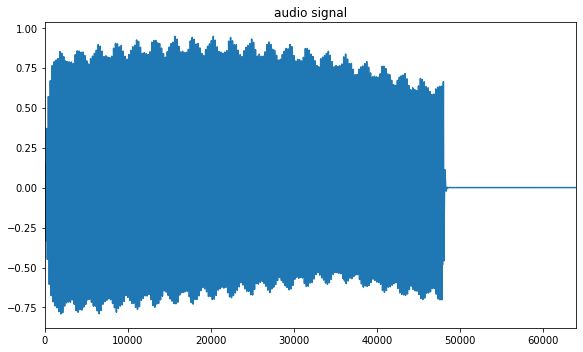

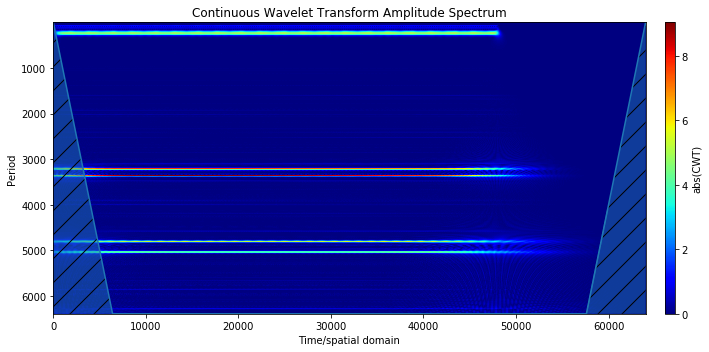

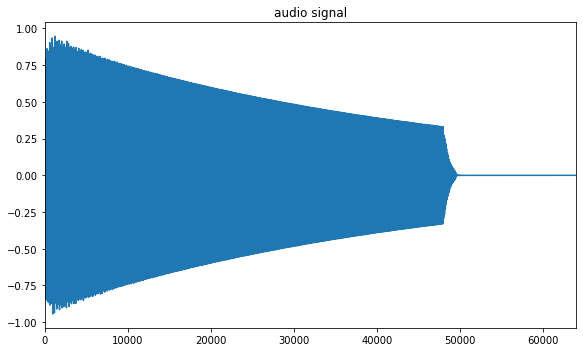

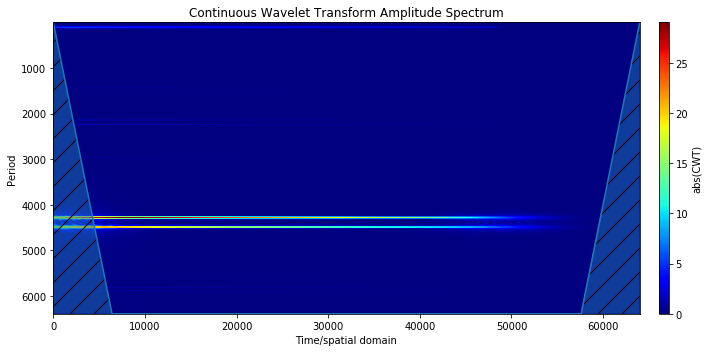

In [34]:
zoom = [0,-1]
for i in range(2) :
    y = trainDataset[i][0]
    dt = np.linspace(0,4,len(trainDataset[0][0]))
    
    # plot the signal 
    fig1, ax1 = plt.subplots(1, 1, figsize=(8.2,5));  
    lines = ax1.plot(y[zoom[0]:zoom[1]]); 
    ax1.set_xlim(0, len(dt[zoom[0]:zoom[1]]))
    ax1.set_title("audio signal")
    fig1.tight_layout()

    # and a range of scales to perform the transform
    scales = scg.periods2scales( np.arange(1, len(y)/10.,10) )

    # and the scaleogram
    ax2 = scg.cws(y, scales=scales, figsize=(10,5)); 
    plt.tight_layout()

In [45]:
line = ax2.lines[0]
print(np.shape(line))
ttt = line.get_xydata()
print(np.shape(ttt))
# plt.imshow(ttt)

()
(64001, 2)


In [49]:
scg.set_default_wavelet('cmor1-1.5')
out = scg.fastcwt(y, scales=scales,wavelet=scg.get_default_wavelet())

In [64]:
print(np.shape(out[0]))
print(np.shape(out[1][0]))


(640, 64000)
()


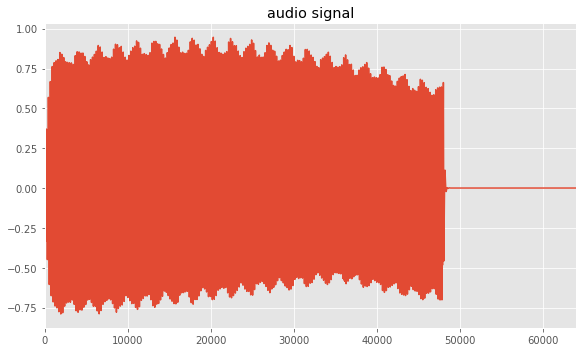

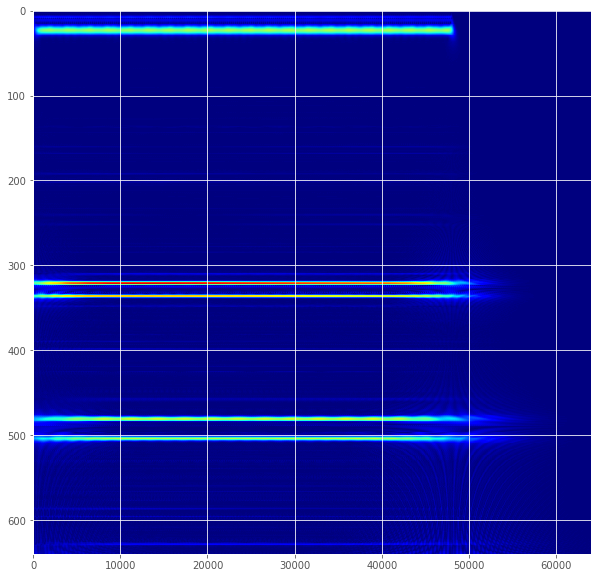

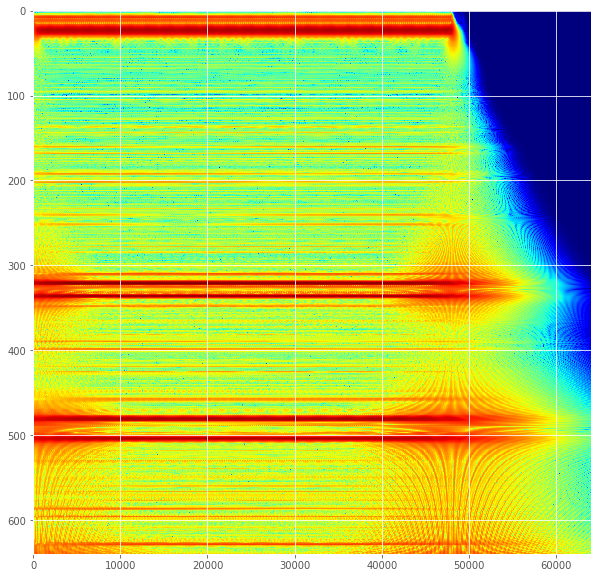

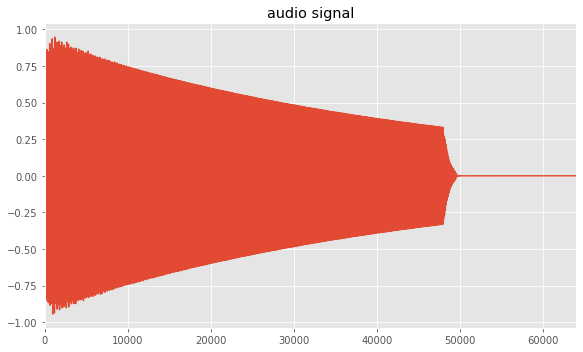

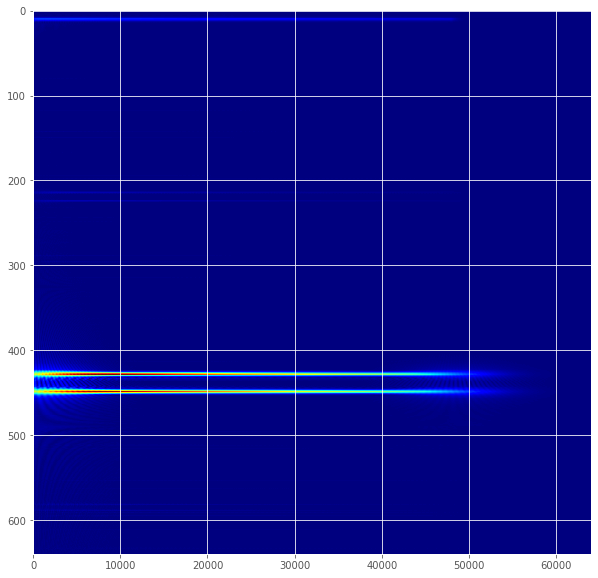

...

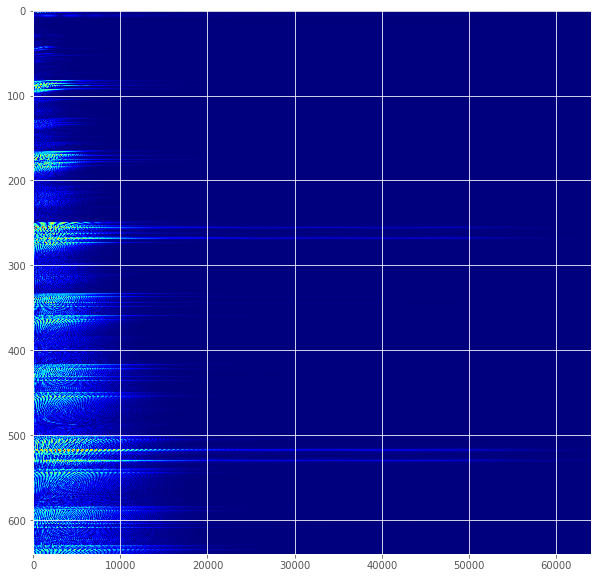

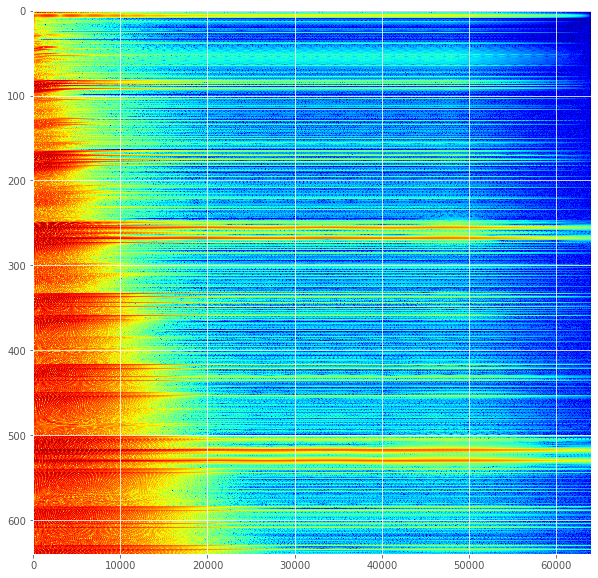

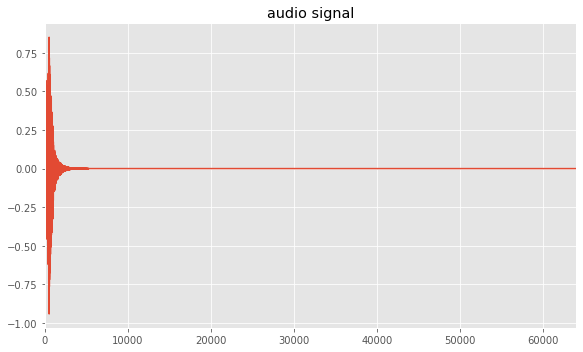

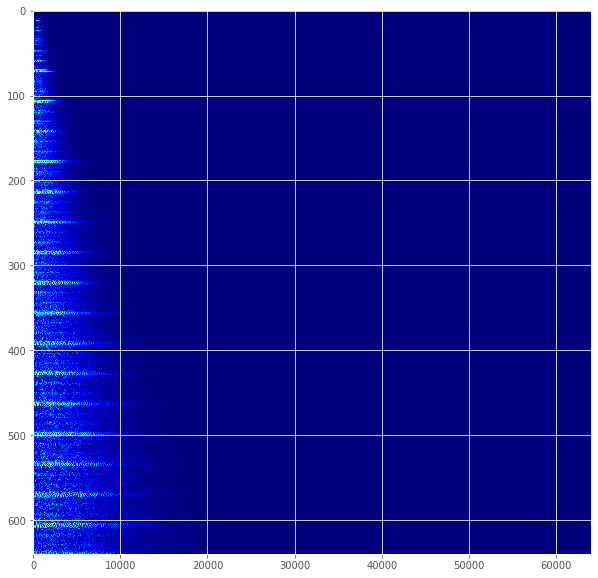

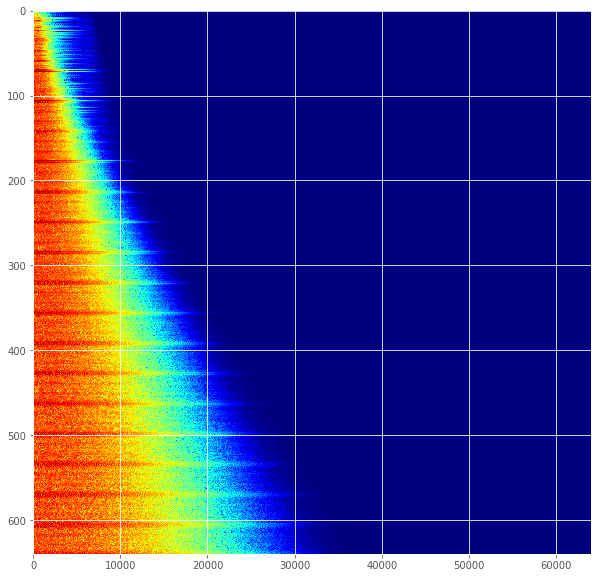

In [82]:
zoom = [0,-1]
for i in range(20) :
    y = trainDataset[i][0]
    dt = np.linspace(0,4,len(trainDataset[0][0]))
    
    scales = scg.periods2scales( np.arange(1, len(y)/10.,10) )

    
    # plot the signal 
    fig1, ax1 = plt.subplots(1, 1, figsize=(8.2,5));  
    lines = ax1.plot(y[zoom[0]:zoom[1]]); 
    ax1.set_xlim(0, len(dt[zoom[0]:zoom[1]]))
    ax1.set_title("audio signal")
    fig1.tight_layout()

    scg.set_default_wavelet('cmor1-1.5')
    out = scg.fastcwt(y, scales=scales,wavelet=scg.get_default_wavelet())
    plt.figure(figsize=(10,10))
    plt.imshow(np.abs(out[0]),aspect='auto',cmap='jet')
    plt.show()
    plt.figure(figsize=(10,10))
    plt.imshow(np.log(np.abs(out[0])+0.00001),aspect='auto',cmap='jet')
    plt.show()

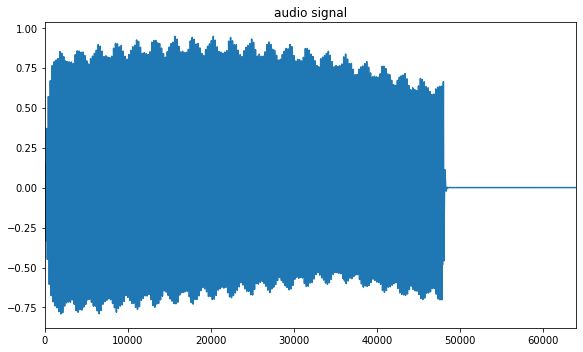

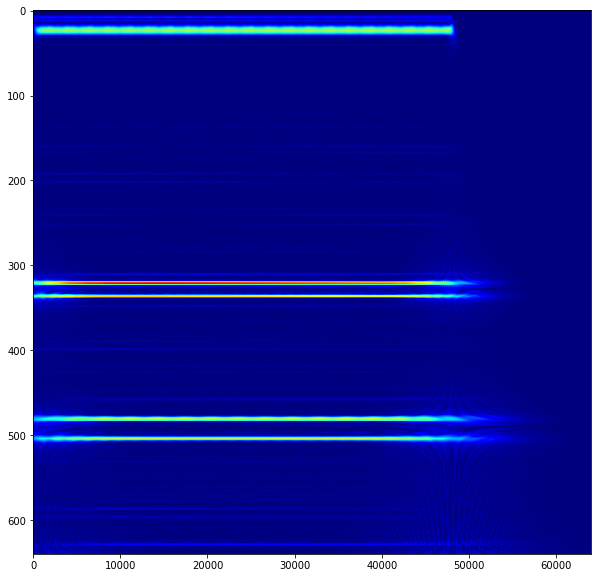

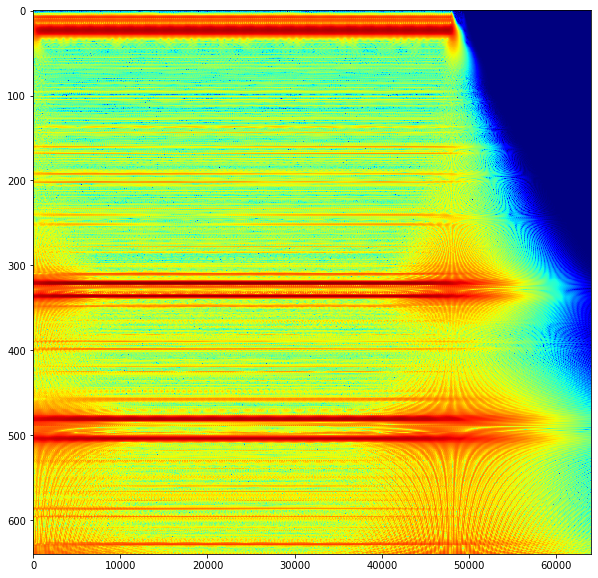

In [10]:
zoom = [0,-1]
for i in range(1) :
    y = trainDataset[i][0]
    dt = np.linspace(0,4,len(trainDataset[0][0]))
    
    scales = scg.periods2scales( np.arange(1, len(y)/10.,10) )

    
    # plot the signal 
    fig1, ax1 = plt.subplots(1, 1, figsize=(8.2,5));  
    lines = ax1.plot(y[zoom[0]:zoom[1]]); 
    ax1.set_xlim(0, len(dt[zoom[0]:zoom[1]]))
    ax1.set_title("audio signal")
    fig1.tight_layout()

    scg.set_default_wavelet('cmor1-1.5')
    out = scg.fastcwt(y, scales=scales,wavelet=scg.get_default_wavelet())
    plt.figure(figsize=(10,10))
    plt.imshow(np.abs(out[0]),aspect='auto',cmap='jet')
    plt.show()
    plt.figure(figsize=(10,10))
    plt.imshow(np.log(np.abs(out[0])+0.00001),aspect='auto',cmap='jet')
    plt.show()

In [11]:
np.shape(out[0])

(640, 64000)

In [6]:
print (type(trainDataset[0][0]))
print(trainDataset[0])
y = np.array(trainDataset[0])
print (y.shape)

<class 'numpy.ndarray'>
[array([0., 0., 0., ..., 0., 0., 0.]), 6]
(2,)


In [7]:
def waveletTransform(data, scale, dt_step, family='mexh'):
    return pywt.cwt(data,scale,family,dt_step)

In [9]:
def outputdim(i,k,p,s):
    return int((i-k+2.*p)/s +1)

In [10]:
def ppp (o1,o2,text) :
    print(text)
    print(o1)
    print(o2)
    print("+"*30)

In [15]:
out1 = outputdim(640,5,0,1)
out2 = outputdim(64000,10,0,1)
ppp(out1,out2,text="conv1")
out1 = outputdim(out1,2,0,2)
out2 = outputdim(out2,5,0,5)
ppp(out1,out2,text="max pooling 1")

out1 = outputdim(out1,5,0,2)
out2 = outputdim(out2,10,0,2)
ppp(out1,out2,text="conv2")
out1 = outputdim(out1,2,0,2)
out2 = outputdim(out2,5,0,5)
ppp(out1,out2,text="max pooling 2")

out1 = outputdim(out1,5,0,2)
out2 = outputdim(out2,10,0,2)
ppp(out1,out2,text="conv 3")
out1 = outputdim(out1,2,0,2)
out2 = outputdim(out2,5,0,5)
ppp(out1,out2,text="max pooling 3")

out1 = outputdim(out1,5,0,2)
out2 = outputdim(out2,10,0,2)
ppp(out1,out2,text="conv 4")
out1 = outputdim(out1,2,0,2)
out2 = outputdim(out2,5,0,5)
ppp(out1,out2,text="max pooling 4")



conv1
636
63991
++++++++++++++++++++++++++++++
max pooling 1
318
12798
++++++++++++++++++++++++++++++
conv2
157
6395
++++++++++++++++++++++++++++++
max pooling 2
78
1279
++++++++++++++++++++++++++++++
conv 3
37
635
++++++++++++++++++++++++++++++
max pooling 3
18
127
++++++++++++++++++++++++++++++
conv 4
7
59
++++++++++++++++++++++++++++++
max pooling 4
3
11
++++++++++++++++++++++++++++++


In [31]:
class WaveletCNN(nn.Module):
    def __init__(self, device):
        super(WaveletCNN, self).__init__()
        self.first_conv = nn.Conv2d(1, 20, [5,10], 1)
        self.second_conv = nn.Conv2d(20, 50, [5,10], 2)
        self.third_conv = nn.Conv2d(50, 50, [5,10], 2)        
        self.fourth_conv = nn.Conv2d(50, 50, [5,10], 2)        
        self.fc1 = nn.Linear(50*3*11, 500)
        self.fc2 = nn.Linear(500, 10)
        self.device = device

    def forward(self, x):
        
        
        for index, audio in enumerate(x.cpu().numpy()):
            dt = np.linspace(0,4,len(audio))
            scales = scg.periods2scales( np.arange(1, len(audio)/10.,10) )

            scg.set_default_wavelet('cmor1-1.5')
            out = scg.fastcwt(audio, scales=scales,wavelet=scg.get_default_wavelet())
            scaleogram_log = np.log(np.abs(out[0])+0.00001)
         
        
        x = torch.from_numpy(scaleogram_log[:, np.newaxis, :, :]).to(self.device).float()
        
        # (1, 255, 64000) to (20,251,63991)
        x = F.relu(self.first_conv(x))
        # (20,251,63991) to (20,125,3198)
        x = F.max_pool2d(x, [2,5], [2,5])
        # (20,125,3198) to (50,61,1595)
        x = F.relu(self.second_conv(x))
        # (50,61,1595) to (50,30,79)
        x = F.max_pool2d(x, [2,5], [2,5])
        # (50,30,79) to (50,13,35)
        x = F.relu(self.third_conv(x))
        # (50,13,35) to (50,6,3)
        x = F.max_pool2d(x, [2,5], [2,5])
        # 
        x = F.relu(self.fourth_conv(x))
        # (50,13,35) to (50,6,3)
        x = F.max_pool2d(x, [2,5], [2,5])
        
        x = x.view(-1, 3*11*50)

        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return F.log_softmax(x, dim=1)

In [34]:
print(WaveletCNN(device))

WaveletCNN(
  (first_conv): Conv2d(1, 20, kernel_size=[5, 10], stride=(1, 1))
  (second_conv): Conv2d(20, 50, kernel_size=[5, 10], stride=(2, 2))
  (third_conv): Conv2d(50, 50, kernel_size=[5, 10], stride=(2, 2))
  (fourth_conv): Conv2d(50, 50, kernel_size=[5, 10], stride=(2, 2))
  (fc1): Linear(in_features=1650, out_features=500, bias=True)
  (fc2): Linear(in_features=500, out_features=10, bias=True)
)


In [35]:
def plotWavelet (coeffs, freqs, dt) :
    power = (abs(coeffs)) ** 2 + 0.000000000001
    period = 1. / freqs
    levels = [0.0625, 0.125, 0.25, 0.5, 1, 2, 4, 8]
    contourlevels = np.log2(levels)
    
    
    print(power.shape)
    print(period.shape)
    fig, ax = plt.subplots(figsize=(10, 5))
    im = ax.contourf(dt, np.log2(period), np.log2(power), contourlevels, extend='both',cmap=plt.cm.seismic)
    print(im)
    print(im.levels)
    plt.show()
    
    print(period.shape)
    print(dt.shape)
    
    fig, ax = plt.subplots(figsize=(10, 5))
    #h, binx, biny = np.histogram2d(period, np.log2(power[5]),bins=[100,100])
    plt.imshow(np.log2(power),aspect='auto')
    plt.show()
    
def plotAmplitude (data, dt) :
    fig, ax = plt.subplots(figsize=(10, 5))
    plt.plot(dt,data)
    plt.show()

In [16]:
class2study = 4
width = np.arange(1,256)

for i in range(1) :
    if trainDataset[i][1] == class2study or True :
        print("class: {0}".format(trainDataset[i][1]))
        y = trainDataset[i][0]
        dt = np.linspace(0,4,len(trainDataset[0][0]))
#         coef, freq = waveletTransform(y,width,dt[1]-dt[0])
        
#         print(np.shape(coef))
#         print(np.shape(freq))
#         plt.plot(freq)
#         plt.show()
#         #print(coef.shape)
#         #print(freq.shape)
#         plotWavelet(coef,freq,dt)
#         plotAmplitude(y,dt)
        np.save("test.pnz",y)

class: 6


(129, 64000)
129
129
8
(129, 64000)


//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: divide by zero encountered in log2
  


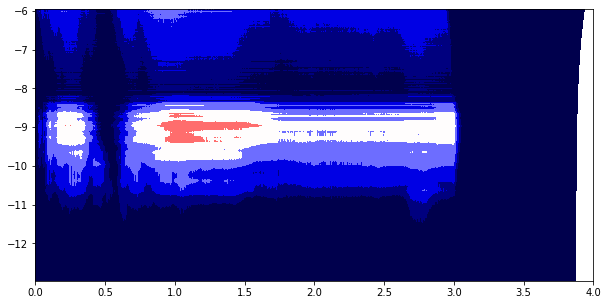

In [18]:
plotWavelet(coef,freq,dt)

In [ ]:
plotWavelet(coef,freq,dt)

In [ ]:
class2study = 0
width = np.arange(1,128)

for i in range(20) :
    if trainDataset[i][1] == class2study :
        y = trainDataset[i][0]
        dt = np.linspace(0,4,len(trainDataset[0][0]))
        coef, freq = waveletTransform(y,width,dt[1]-dt[0])
        plotWavelet(coef,freq,dt)
        plotAmplitude(y,dt)
        

In [ ]:
coeffs, freqs = pywt.cwt(y,width ,'cmor',dt[1]-dt[0])

//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: divide by zero encountered in log2
  


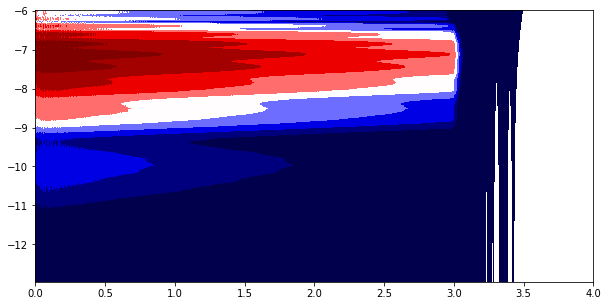

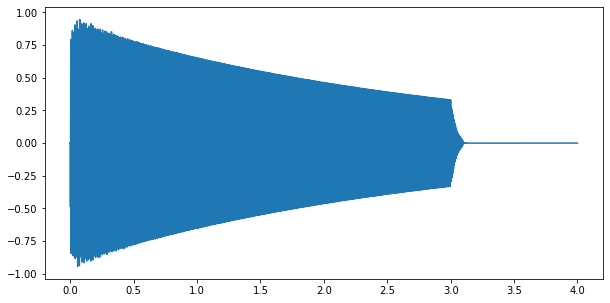

In [111]:
power = (abs(coeffs)) ** 2
period = 1. / freqs
levels = [0.0625, 0.125, 0.25, 0.5, 1, 2, 4, 8]
contourlevels = np.log2(levels)


fig, ax = plt.subplots(figsize=(10, 5))
im = ax.contourf(dt, np.log2(period), np.log2(power), contourlevels, extend='both',cmap=plt.cm.seismic)



plt.show()
fig, ax = plt.subplots(figsize=(10, 5))
plt.plot(dt,y)
plt.show()
#yticks = 2**np.arange(np.ceil(np.log2(period.min())), np.ceil(np.log2(period.max())))
#ax.set_yticks(np.log2(yticks))
#ax.set_yticklabels(yticks)
#ax.invert_yaxis()
#ylim = ax.get_ylim()
#ax.set_ylim(ylim[0], -1)

#cbar_ax = fig.add_axes([0.95, 0.5, 0.03, 0.25])
#fig.colorbar(im, cax=cbar_ax, orientation="vertical")
#plt.show()

In [89]:
#print(cwtmatr.shape)
#print(freqs.shape)
#print(freqs)

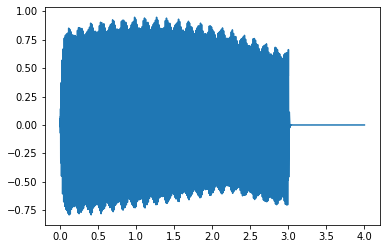

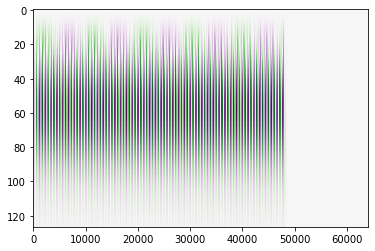

In [90]:
plt.plot(dt,y)
plt.show()
plt.imshow(cwtmatr, cmap='PRGn', aspect='auto',
           vmax=abs(cwtmatr).max(), vmin=-abs(cwtmatr).max())  # doctest: +SKIP
plt.show() # doctest: +SKIP

# discrete wavelet transform\

In [76]:
pywt.wavelist(kind='discrete')

['bior1.1',
 'bior1.3',
 'bior1.5',
 'bior2.2',
 'bior2.4',
 'bior2.6',
 'bior2.8',
 'bior3.1',
 'bior3.3',
 'bior3.5',
 'bior3.7',
 'bior3.9',
 'bior4.4',
 'bior5.5',
 'bior6.8',
 'coif1',
 'coif2',
 'coif3',
 'coif4',
 'coif5',
 'coif6',
 'coif7',
 'coif8',
 'coif9',
 'coif10',
 'coif11',
 'coif12',
 'coif13',
 'coif14',
 'coif15',
 'coif16',
 'coif17',
 'db1',
 'db2',
 'db3',
 'db4',
 'db5',
 'db6',
 'db7',
 'db8',
 'db9',
 'db10',
 'db11',
 'db12',
 'db13',
 'db14',
 'db15',
 'db16',
 'db17',
 'db18',
 'db19',
 'db20',
 'db21',
 'db22',
 'db23',
 'db24',
 'db25',
 'db26',
 'db27',
 'db28',
 'db29',
 'db30',
 'db31',
 'db32',
 'db33',
 'db34',
 'db35',
 'db36',
 'db37',
 'db38',
 'dmey',
 'haar',
 'rbio1.1',
 'rbio1.3',
 'rbio1.5',
 'rbio2.2',
 'rbio2.4',
 'rbio2.6',
 'rbio2.8',
 'rbio3.1',
 'rbio3.3',
 'rbio3.5',
 'rbio3.7',
 'rbio3.9',
 'rbio4.4',
 'rbio5.5',
 'rbio6.8',
 'sym2',
 'sym3',
 'sym4',
 'sym5',
 'sym6',
 'sym7',
 'sym8',
 'sym9',
 'sym10',
 'sym11',
 'sym12',
 'sym13',

class 0


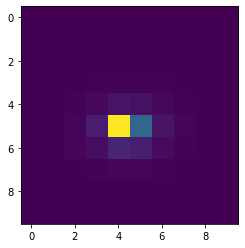

class 0


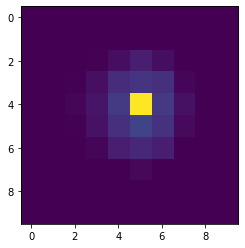

class 0


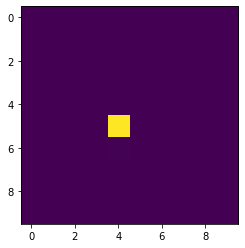

class 0


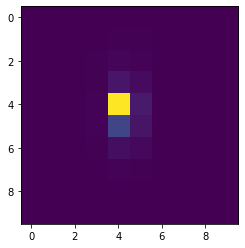

class 0


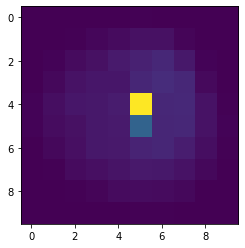

class 0


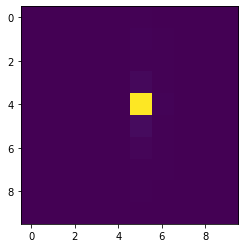

class 0


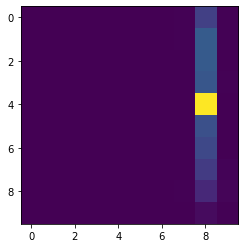

class 0


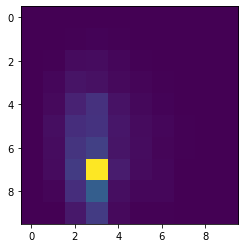

class 0


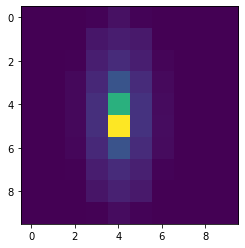

class 0


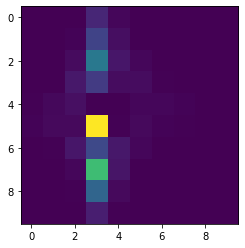

class 0


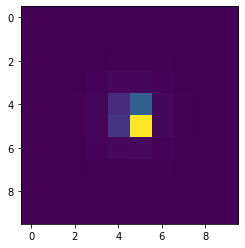

class 0


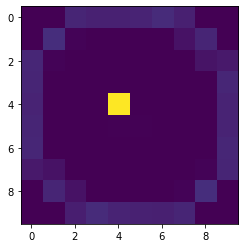

class 0


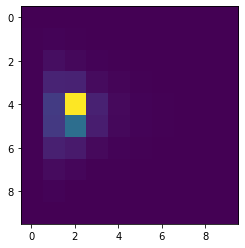

class 0


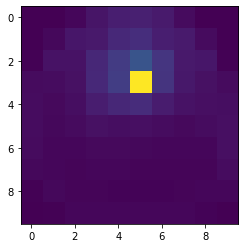

class 0


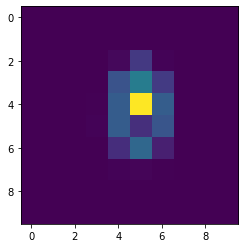

class 0


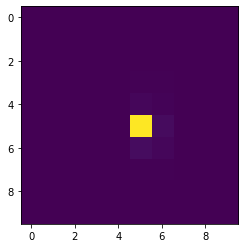

class 0


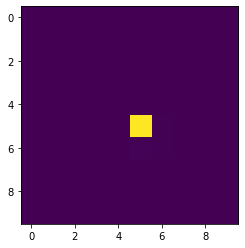

class 0


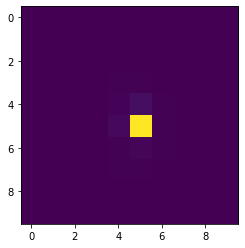

class 0


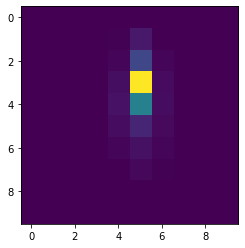

class 0


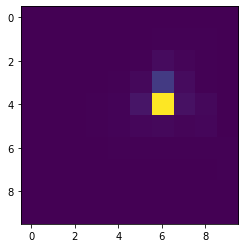

class 0


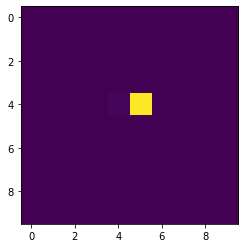

class 0


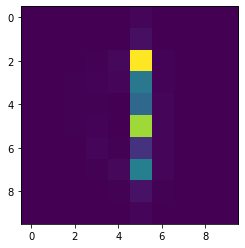

class 0


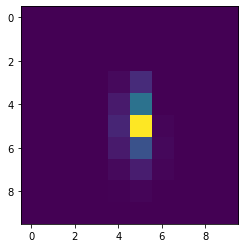

In [79]:
y = trainDataset[0][0]

class2study = 0
for i in range(100) :
    if trainDataset[i][1] == class2study :
        y = trainDataset[i][0]
        print("class {0}".format(trainDataset[i][1]))
        ca,cd = pywt.dwt(y,'db1')  
        h, binx, biny = np.histogram2d(ca,cd,[10,10])
        plt.imshow(h)
        plt.show()

In [74]:
ca,cd = pywt.dwt(y,'db1')

In [75]:
print(ca.shape)
print(cd.shape)

(32000,)
(32000,)


[[0.00e+00 4.80e+01 2.16e+02 3.18e+02 3.03e+02 2.27e+02 1.70e+01 0.00e+00
  0.00e+00 0.00e+00]
 [1.70e+01 4.23e+02 5.28e+02 3.99e+02 3.92e+02 7.20e+02 2.61e+02 6.00e+00
  0.00e+00 0.00e+00]
 [1.08e+02 5.45e+02 5.20e+02 6.61e+02 6.06e+02 9.22e+02 2.85e+02 1.14e+02
  0.00e+00 0.00e+00]
 [5.30e+01 6.81e+02 1.60e+02 7.46e+02 8.18e+02 4.93e+02 1.46e+02 2.27e+02
  4.00e+00 0.00e+00]
 [9.00e+00 6.87e+02 4.99e+02 8.36e+03 9.82e+02 4.66e+02 1.14e+02 2.88e+02
  2.90e+01 1.00e+00]
 [1.26e+02 3.59e+02 4.63e+02 6.35e+02 7.53e+02 9.90e+01 1.10e+02 3.39e+02
  3.70e+01 0.00e+00]
 [2.20e+02 2.15e+02 3.66e+02 5.24e+02 3.69e+02 9.00e+00 1.59e+02 3.87e+02
  8.00e+00 0.00e+00]
 [2.44e+02 2.97e+02 2.49e+02 1.02e+02 8.60e+01 7.20e+01 2.57e+02 3.26e+02
  0.00e+00 0.00e+00]
 [7.40e+01 4.27e+02 1.87e+02 1.40e+02 1.41e+02 2.17e+02 3.69e+02 6.90e+01
  0.00e+00 0.00e+00]
 [0.00e+00 9.00e+01 2.17e+02 2.85e+02 2.88e+02 2.27e+02 5.90e+01 0.00e+00
  0.00e+00 0.00e+00]]


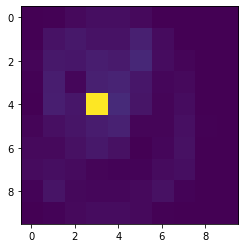

In [67]:
h, binx, biny = np.histogram2d(ca,cd,[10,10])
print(h)
plt.imshow(h)

In [66]:
cwtmatr, freqs = pywt.cwt(trainDataset[0][0],scales=np.ones(trainDataset[0][0]) ,wavelet='mexh')
#plt.imshow(cwtmatr, extent=[-1, 1, 1, 31], cmap='PRGn', aspect='auto',
#           vmax=abs(cwtmatr).max(), vmin=-abs(cwtmatr).max())  # doctest: +SKIP
#plt.show() # doctest: +SKIP

ValueError: sequence too large; cannot be greater than 32

In [ ]:
print(trainDataset[0])
plt.plot(trainDataset[0][0])
plt.show()
plt.plot(ffts(trainDataset[0][0]))
plt.show()

In [8]:
if do_plots:
    # how many instruments are there?
    dummy_count = np.zeros(20)

    for sample in trainDataset:
        dummy_count[sample[1]] += 1

    labels_count = []
    for elem in dummy_count:
        if elem != 0:
            labels_count.append(elem)

    print(labels_count)

[2332.0, 450.0, 348.0, 1000.0, 1967.0, 1021.0, 1285.0, 497.0, 744.0, 356.0]


In [9]:
if do_plots:
    nmbr_classes = len(labels_count)
    print('nmbr_classes: ', nmbr_classes)

nmbr_classes:  10


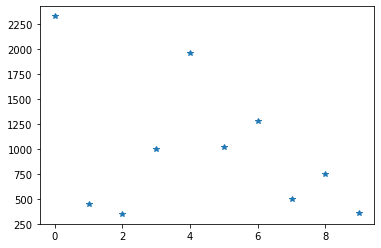

In [10]:
if do_plots:
    plt.plot(labels_count, '*')

In [11]:
if do_plots:
    # plot one of each

    done = np.zeros(nmbr_classes)
    examples = []

    for sample in trainDataset:
        if done[sample[1]] == 0:
            examples.append(sample)
            done[sample[1]] = 1

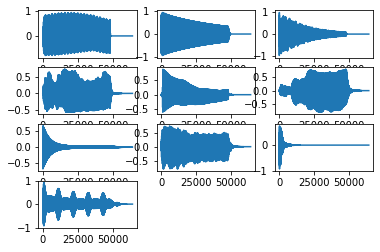

In [12]:
if do_plots:
    plt.subplot(431)
    plt.plot(examples[0][0])

    plt.subplot(432)
    plt.plot(examples[1][0])

    plt.subplot(433)
    plt.plot(examples[2][0])

    plt.subplot(434)
    plt.plot(examples[3][0])

    plt.subplot(435)
    plt.plot(examples[4][0])

    plt.subplot(436)
    plt.plot(examples[5][0])

    plt.subplot(437)
    plt.plot(examples[6][0])

    plt.subplot(438)
    plt.plot(examples[7][0])

    plt.subplot(439)
    plt.plot(examples[8][0])

    plt.subplot(4,3,10)
    plt.plot(examples[9][0])

    plt.show()

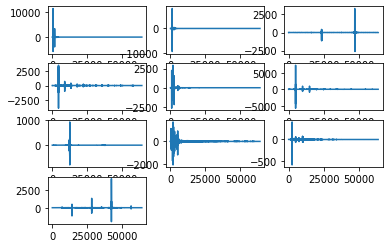

In [20]:
if do_plots:

    # plot one of each in FFT

    plt.subplot(431)
    plt.plot(ffts(examples[0][0]))

    plt.subplot(432)
    plt.plot(ffts(examples[1][0]))

    plt.subplot(433)
    plt.plot(ffts(examples[2][0]))

    plt.subplot(434)
    plt.plot(ffts(examples[3][0]))

    plt.subplot(435)
    plt.plot(ffts(examples[4][0]))

    plt.subplot(436)
    plt.plot(ffts(examples[5][0]))

    plt.subplot(437)
    plt.plot(ffts(examples[6][0]))

    plt.subplot(438)
    plt.plot(ffts(examples[7][0]))

    plt.subplot(439)
    plt.plot(ffts(examples[8][0]))

    plt.subplot(4,3,10)
    plt.plot(ffts(examples[9][0]))

    plt.show()

In [21]:
if do_plots:

    for sample in examples:
        display(Audio(sample[0], rate=sample_rate))

### Dataloaders

In [13]:
# validation split is done here

train_loader, validation_loader = get_dataloaders(trainDataset, 
                                                  batch_size = args.batch_size, 
                                                  validation_split = validation_split, 
                                                  shuffle_dataset = True, 
                                                  random_seed = None)

for samples, instrument_family_target in train_loader:
        print(samples.shape, instrument_family_target.shape,
              instrument_family_target.data)
        print(torch.min(samples), torch.max(samples))
        print(trainDataset.transformInstrumentsFamilyToString(instrument_family_target.data))
        break
        
for samples, instrument_family_target in validation_loader:
        print(samples.shape, instrument_family_target.shape,
              instrument_family_target.data)
        print(torch.min(samples), torch.max(samples))
        print(trainDataset.transformInstrumentsFamilyToString(instrument_family_target.data))
        break

torch.Size([64, 64000]) torch.Size([64]) tensor([0, 4, 5, 3, 4, 4, 1, 9, 4, 5, 4, 6, 0, 4, 5, 4, 0, 4, 7, 0, 4, 8, 5, 0,
        6, 2, 5, 0, 1, 3, 9, 0, 4, 9, 2, 6, 0, 0, 0, 0, 7, 4, 3, 4, 5, 4, 5, 7,
        0, 7, 0, 0, 4, 9, 6, 9, 8, 4, 5, 3, 4, 3, 4, 6])
tensor(-0.9569, dtype=torch.float64) tensor(0.9694, dtype=torch.float64)
['bass' 'keyboard' 'mallet' 'guitar' 'keyboard' 'keyboard' 'brass' 'vocal'
 'keyboard' 'mallet' 'keyboard' 'organ' 'bass' 'keyboard' 'mallet'
 'keyboard' 'bass' 'keyboard' 'reed' 'bass' 'keyboard' 'string' 'mallet'
 'bass' 'organ' 'flute' 'mallet' 'bass' 'brass' 'guitar' 'vocal' 'bass'
 'keyboard' 'vocal' 'flute' 'organ' 'bass' 'bass' 'bass' 'bass' 'reed'
 'keyboard' 'guitar' 'keyboard' 'mallet' 'keyboard' 'mallet' 'reed' 'bass'
 'reed' 'bass' 'bass' 'keyboard' 'vocal' 'organ' 'vocal' 'string'
 'keyboard' 'mallet' 'guitar' 'keyboard' 'guitar' 'keyboard' 'organ']
torch.Size([64, 64000]) torch.Size([64]) tensor([5, 5, 4, 0, 5, 3, 3, 4, 0, 4, 0, 4, 0, 6, 6, 3, 8, 

In [17]:
test_loader = data.DataLoader(testDataset, batch_size=args.batch_size, shuffle=False) #!!! shuffle should be false
for samples,n in test_loader:
    
        print(samples)
        print(samples.shape)
        print(torch.min(samples), torch.max(samples))
        break

tensor([[ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ...,  0.0000e+00,
          0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ...,  0.0000e+00,
          0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ...,  0.0000e+00,
          0.0000e+00,  0.0000e+00],
        ...,
        [ 0.0000e+00,  0.0000e+00, -3.0519e-05,  ...,  0.0000e+00,
          0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ...,  0.0000e+00,
          0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  ...,  0.0000e+00,
          0.0000e+00,  0.0000e+00]], dtype=torch.float64)
torch.Size([64, 64000])
tensor(-0.9531, dtype=torch.float64) tensor(0.9467, dtype=torch.float64)


### Main

In [ ]:
print()

In [37]:
model = args.net(device).to(device)

print(WaveletCNN(device))
model = WaveletCNN(device).to(device)

WaveletCNN(
  (first_conv): Conv2d(1, 20, kernel_size=[5, 10], stride=(1, 1))
  (second_conv): Conv2d(20, 50, kernel_size=[5, 10], stride=(2, 2))
  (third_conv): Conv2d(50, 50, kernel_size=[5, 10], stride=(2, 2))
  (fourth_conv): Conv2d(50, 50, kernel_size=[5, 10], stride=(2, 2))
  (fc1): Linear(in_features=1650, out_features=500, bias=True)
  (fc2): Linear(in_features=500, out_features=10, bias=True)
)


In [38]:
# Main
optimizer = optim.SGD(model.parameters(), lr=args.lr, 
                      momentum=args.momentum)

info = {'lowest F1' : 100,
        'saved epoch' : None}

In [39]:
for epoch in range(1+3, args.epochs + 1 +3):
    train(args, model, device, train_loader, optimizer, epoch, start_time = time.time())
    f1 = get_mean_F1(model, validation_loader)
    print('after epoch {} got f1 score of {}'.format(epoch , f1))
    if f1 < info['lowest F1']:
        info['lowest F1'] = f1
        info['saved epoch'] = epoch 
        test(args, model, device, test_loader, epoch, trainDataset, testDataset, path_submission)
        torch.save(model, path_model)
        print('currently best model --> saved')

IndexError: too many indices for array

### Load Model

In [21]:
if load_model:
    model = torch.load(path_model)

In [22]:
get_mean_F1(model, validation_loader)

0.1318359375

In [23]:
epoch = 4
test(args, model, device, test_loader, epoch, trainDataset, testDataset, path_submission)

saved predictions


In [24]:
print(model)

SpectrogramCNN(
  (first_conv): Conv2d(1, 20, kernel_size=(5, 5), stride=(1, 1))
  (second_conv): Conv2d(20, 50, kernel_size=(5, 5), stride=(2, 2))
  (third_conv): Conv2d(50, 50, kernel_size=(5, 5), stride=(2, 2))
  (fc1): Linear(in_features=1800, out_features=500, bias=True)
  (fc2): Linear(in_features=500, out_features=10, bias=True)
)
